In [2]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from matplotlib import rcParams
import seaborn as sns
from scipy import stats
import statistics
from matplotlib.patches import FancyArrow
from collections import Counter
import json
from urllib.parse import urlparse  

plt.rcParams['figure.dpi'] = 900

# 将X/Y轴的刻度线方向设置向内
plt.rcParams['xtick.direction'] = 'in'
plt.rcParams['ytick.direction'] = 'in'

# 设置字体
plt.rcParams['axes.unicode_minus'] = False
plt.rcParams['font.family'] = 'Microsoft Yahei'
# plt.rcParams['font.family'] = 'Times New Roman'

# 设置公式字体
config = {
    "mathtext.fontset": 'stix',
}
rcParams.update(config)

##### 加载Json到内存

In [8]:
# 该文件为 C4EL.LE 的汇总 https://github.com/Computational-social-science/C4EL/tree/main/LE
filename = 'en_data_final_1.json'

local_data = []
with open('./data/'+filename, 'r', encoding='utf-8') as file:
    local_data = json.load(file)
print(len(local_data))
print(local_data[0].keys())
print(local_data[0])

# 统计词组类型
phrases = []

for ele in local_data:
    text = ele['text']
    phrase_list = ele['phrase']
    for p in phrase_list:
        phrases.append(p)


latin_phrases = []
apper_times = {}
# 使用Counter统计元素个数
element_counts = Counter(phrases)
# 按照出现次数降序排序
sorted_counts = sorted(element_counts.items(), key=lambda x: x[1], reverse=True)
# 输出排序结果
for element, count in sorted_counts:
    # print(f"{element}: {count}")
    latin_phrases.append(element)
    apper_times[element] = count

4972126
dict_keys(['text', 'timestamp', 'language', 'phrase', 'url'])
{'text': {'in situ': '\nWe have a long history of highly complex projects completed on time and to budget. Projects are often carried out with the building’s occupying tenants in situ, causing minimal disruption.\nJPW Osprey Limited’s approach to health and safety is extremely important on all projects.'}, 'timestamp': '2019-04-26T12:51:38Z', 'language': 'en', 'phrase': {'in situ': 1}, 'url': 'http://jpwosprey.com/'}


#### Websites count

4972126
4972126
[('patents.google.com', 12648), ('www.ncbi.nlm.nih.gov', 8640), ('en.wikipedia.org', 7751), ('journals.plos.org', 6049), ('caselaw.findlaw.com', 5901), ('en.m.wikipedia.org', 5704), ('link.springer.com', 5183), ('www.wipo.int', 5001), ('scholars.duke.edu', 4529), ('supreme.justia.com', 4399), ('www.frontiersin.org', 4266), ('law.justia.com', 3936), ('www.forbes.com', 3909), ('www.theguardian.com', 3894), ('casetext.com', 3885), ('www.nytimes.com', 3855), ('www.senioradvice.com', 3837), ('www.faqs.org', 3345), ('www.huffpost.com', 3300), ('www.nature.com', 3110), ('roadsidethoughts.com', 3038), ('www.theatlantic.com', 2934), ('www.latimes.com', 2784), ('ipfs.io', 2652), ('openjurist.org', 2520), ('www.semanticscholar.org', 2518), ('www.biobool.com', 2490), ('www.washingtonpost.com', 2489), ('pubs.rsc.org', 2473), ('www.plumplot.co.uk', 2366), ('www.hindawi.com', 2298), ('www.scribd.com', 2274), ('iovs.arvojournals.org', 2199), ('rd.springer.com', 2048), ('www.aljazeera.c

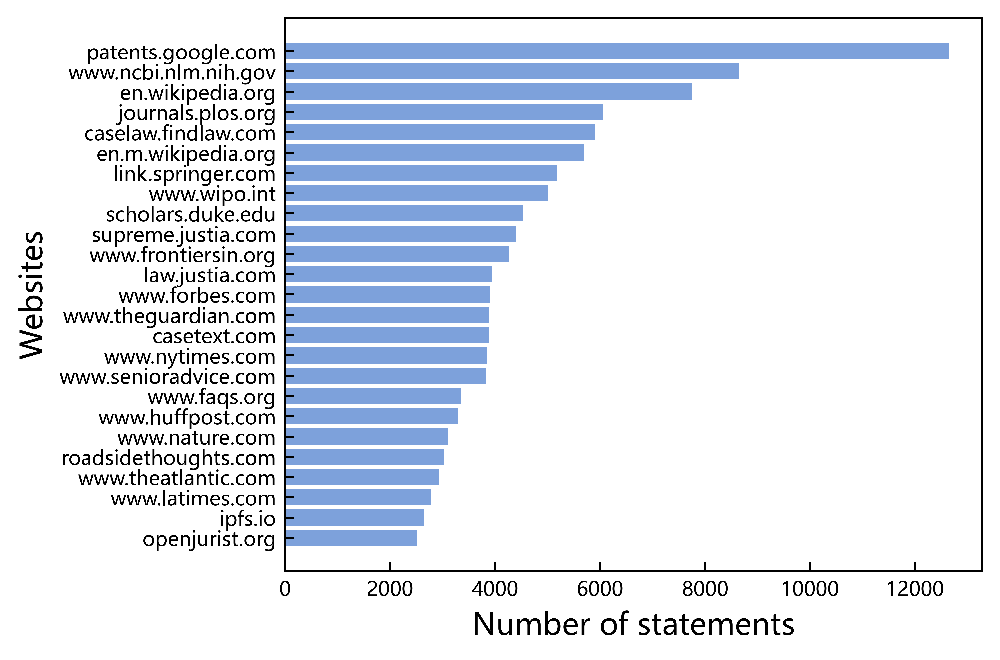

In [9]:
from urllib.parse import urlparse  
  
def get_url_parts(url):  
    result = urlparse(url)  
    return {  
        "scheme": result.scheme,  
        "netloc": result.netloc,  
        "path": result.path,  
        "params": result.params,  
        "query": result.query,  
        "fragment": result.fragment  
    }  
# url = "https://www.jacksonville.com/opinion/editorials/2011-07-30/story/cost-death-time-tough-talk"  
# parts = get_url_parts(url)  
# print(parts['netloc'])


print(len(local_data))
website_infos = []
for ele in local_data:
    url = ele['url']
    if len(url) != 0:
        website = get_url_parts(url)['netloc']
        website_infos.append(website)
# 每一条语句都有完整的url
print(len(website_infos))

# 使用Counter统计元素个数
element_counts = Counter(website_infos)
# 按照出现次数降序排序
sorted_counts = sorted(element_counts.items(), key=lambda x: x[1], reverse=True)
print(sorted_counts)
# 保存数据
all_websites, all_websites_count = [], []
for i, (element, count) in enumerate(sorted_counts):
    all_websites.append(element)
    all_websites_count.append(count)
# pd.DataFrame({'website': all_websites, 'count': all_websites_count}).to_csv('./data/data analysis v2.0/top websites count.csv', index=None)

# 输出排序结果
top_websites, top_websites_count= [], []
for i, (element, count) in enumerate(sorted_counts):
    if i >= 25:
        break
    top_websites.append(element)
    top_websites_count.append(count)
print(top_websites)    
    
# 绘图
fig, ax = plt.subplots(figsize=(5, 4))
# 反转 y 轴
ax.invert_yaxis()
# plt.xscale('log')
plt.barh(top_websites, top_websites_count, height=0.8, color='#7da1db')

plt.ylabel('Websites', fontsize=12)
plt.xlabel('Number of statements', fontsize=12)
# 设置 x 轴刻度字体大小
ax.tick_params(axis='x', labelsize=8)
# 设置 y 轴刻度字体大小
ax.tick_params(axis='y', labelsize=8)
# plt.xticks([2000, 6000, 10000])

#### Top-level domains count

[('com', 2973766), ('org', 644271), ('co.uk', 168899), ('net', 165575), ('edu', 125957), ('com.au', 66998), ('ca', 57829), ('info', 54733), ('gov', 45878), ('eu', 35162), ('in', 32838), ('de', 31803), ('ac.uk', 31795), ('org.uk', 31117), ('co.za', 22600), ('tk', 19259), ('ie', 16439), ('co', 16265), ('us', 15967), ('ru', 15743), ('nl', 15361), ('it', 13051), ('co.nz', 12323), ('io', 12017), ('org.au', 9978), ('fr', 9876), ('edu.au', 9093), ('ch', 8860), ('me', 8801), ('blog', 8727), ('int', 6914), ('uk', 6686), ('be', 6625), ('se', 6622), ('pl', 6074), ('biz', 5989), ('cz', 5391), ('gov.au', 5354), ('es', 5345), ('tv', 4879), ('org.za', 3751), ('dk', 3653), ('co.in', 3519), ('gov.uk', 3396), ('org.nz', 3380), ('jp', 3380), ('no', 3281), ('fi', 3125), ('ro', 3014), ('gr', 2866), ('net.au', 2851), ('at', 2709), ('org.in', 2610), ('sg', 2603), ('xyz', 2512), ('com.sg', 2405), ('cn', 2393), ('com.br', 2220), ('com.pk', 2146), ('edu.sg', 2119), ('pt', 2089), ('ng', 2065), ('ac.za', 2045), (

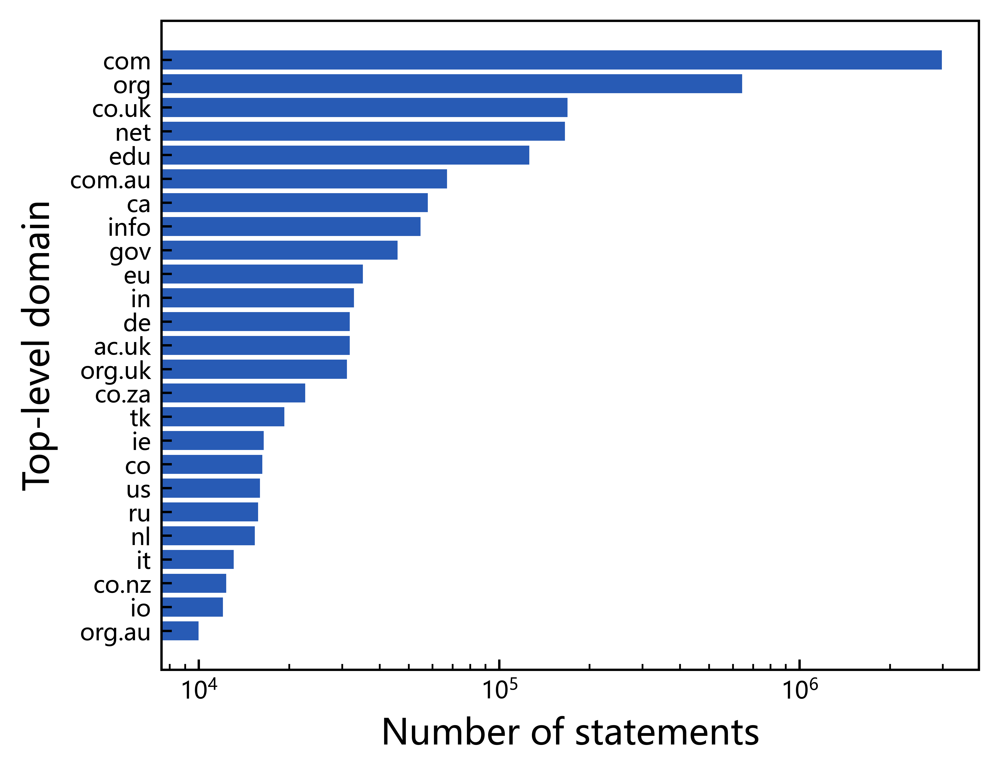

In [13]:
import tldextract
 
url = 'http://news.baidu.com'
def get_domain(url):
    tld = tldextract.extract(url)
    # main_domain = tld.domain + '.' + tld.suffix
    return tld.suffix

# 提取域名结尾
domain_infos = [get_domain(web) for web in website_infos]

# 使用Counter统计元素个数
element_counts = Counter(domain_infos)
# 按照出现次数降序排序
sorted_counts = sorted(element_counts.items(), key=lambda x: x[1], reverse=True)
print(sorted_counts)
# 保存数据
all_domains, all_domains_count = [], []
for i, (element, count) in enumerate(sorted_counts):
    if len(element) == 0:
        continue
    all_domains.append(element)
    all_domains_count.append(count)
# pd.DataFrame({'domain': all_domains, 'count': all_domains_count}).to_csv('./data/data analysis v2.0/top domains count.csv', index=None)


# 输出排序结果
top_domains = []
top_domains_count = []
for i, (domain, count) in enumerate(sorted_counts):
    if len(element) == 0:
        continue
    if i >= 25:
        break
    top_domains.append(domain)
    top_domains_count.append(count)

print(top_domains)

# 绘图
fig, ax = plt.subplots(figsize=(5, 4))
# 反转 y 轴
ax.invert_yaxis()
plt.xscale('log')
plt.barh(top_domains, top_domains_count, height=0.8, color='#285bb5')

plt.ylabel('Top-level domain', fontsize=12)
plt.xlabel('Number of statements', fontsize=12)
# 设置 x 轴刻度字体大小
ax.tick_params(axis='x', labelsize=8)
# 设置 y 轴刻度字体大小
ax.tick_params(axis='y', labelsize=8)

#### 合并图例

In [14]:
def plotPanelA(ax):
    file_path = './data/data analysis v2.0/top-level domains count.csv'
    df_domain = pd.read_csv(file_path)
    # 获取前25的数据
    xvals, yvals = df_domain['top level domain'], df_domain['count']
    xvalue, yvalue = [], []
    for i, (x, y) in enumerate(zip(xvals, yvals)):
        if i >= 25:
            break
        xvalue.append(x)
        yvalue.append(y)
        
    # 反转 y 轴
    ax.invert_yaxis()
    # 去除上方和右侧的空白
    ax.margins(0)
    ax.set_xscale('log')
    
    ax.barh(xvalue, yvalue, height=0.8, color='#6671b5', alpha=0.85)
    
    ax.set_ylabel('Top level domain', fontsize=16)
    ax.set_xlabel('Number of sentences', fontsize=16)
    # 设置 x 轴刻度字体大小
    ax.tick_params(axis='x', labelsize=12)
    # 设置 y 轴刻度字体大小
    ax.tick_params(axis='y', labelsize=12)
    # 设置 x/y轴的范围
    ax.set_xlim(10**(np.log10(np.min(yvalue))*0.95), 10**(np.log10(np.max(yvalue))*1.05))
    ax.set_ylim(25, -1)


def plotPanelB(ax):
    file_path = './data/data analysis v2.0/top websites count.csv'
    df_website = pd.read_csv(file_path)
    # 获取前25的数据
    xvals, yvals = df_website['website'], df_website['count']
    xvalue, yvalue = [], []
    for i, (x, y) in enumerate(zip(xvals, yvals)):
        if i >= 25:
            break
        xvalue.append(x)
        yvalue.append(y)
     # 反转 y 轴
    ax.invert_yaxis()
    # 去除上方和右侧的空白
    ax.margins(0)

    ax.barh(xvalue, yvalue, height=0.8, color='#f79779', alpha=0.8)
    
    ax.set_ylabel('Website', fontsize=16)
    ax.set_xlabel('Number of sentences', fontsize=16)
    # 设置 x 轴刻度字体大小
    ax.tick_params(axis='x', labelsize=12)
    # 设置 y 轴刻度字体大小
    ax.tick_params(axis='y', labelsize=12)
    # 设置 x/y轴的范围
    ax.set_xlim(np.min(yvalue)*0.9, np.max(yvalue)*1.1)
    ax.set_ylim(25, -1)

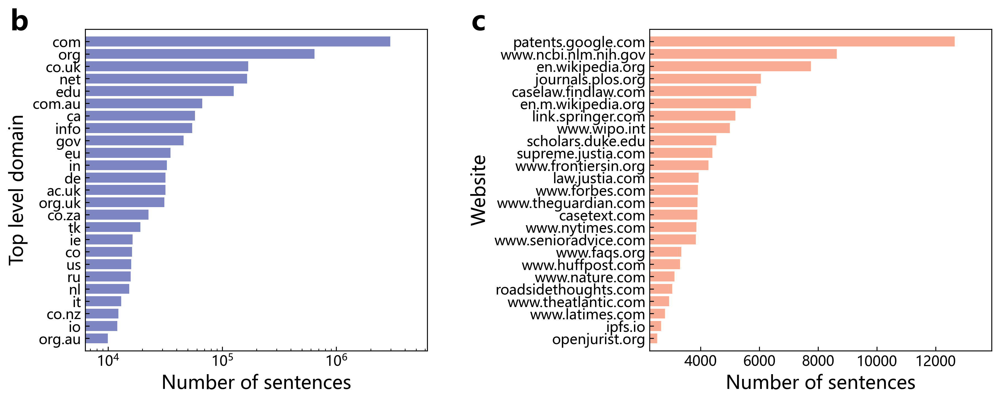

In [15]:
plt.rcParams['figure.dpi'] = 300
fig, axs = plt.subplots(1, 2, figsize=(14, 5), gridspec_kw={'width_ratios': [1, 1]})
plotPanelA(axs[0])
plotPanelB(axs[1])

fig.subplots_adjust(wspace=0.65, hspace=0.22)

fig.text(0.061, 0.93, 'b', fontsize=24, va='top', fontweight='bold')
fig.text(0.455, 0.93, 'c', fontsize=24, va='top', fontweight='bold')

# 保存图表为SVG格式
# plt.savefig('chart.svg', format='svg')

#### 分析前25个网站

In [10]:
# 将ipv4转变成十进制
def ipv4_to_decimal(address):
    parts = address.split('.')
    decimal_ip = 0
    for i in range(4):
        decimal_ip += int(parts[i]) * (256 ** (3 - i))
    return decimal_ip

# 将ipv6转变成十进制
import ipaddress

def ipv6_to_decimal(address):
    try:
        ip = ipaddress.ip_address(address)
        decimal = int(ip)
        return decimal
    except ValueError:
        return None
    
# 将url转换为ip地址
import socket

def get_ip_address(url):
    try:
        ip_address = socket.gethostbyname(url)
        return ip_address
    except socket.gaierror:
        return None
    
    
# 判断是ipv4还是ipv6
import ipaddress

def get_address_type(address):
    try:
        ip = ipaddress.ip_address(address)
        if isinstance(ip, ipaddress.IPv4Address):
            return "IPv4"
        elif isinstance(ip, ipaddress.IPv6Address):
            return "IPv6"
        else:
            return "Unknown"
    except ValueError:
        return "Invalid"


df_ipv4 = pd.read_csv('./data/IP-country database/IP2LOCATION-LITE-DB1.IPV4.CSV', header=None)
df_ipv6 = pd.read_csv('./data/IP-country database/IP2LOCATION-LITE-DB1.IPV6.CSV', header=None)

print(df_ipv4.shape, df_ipv6.shape)
ipv4_country, ipv6_country = [], []

for (start_ip, end_ip, region_conde, country) in zip(df_ipv4[0], df_ipv4[1], df_ipv4[2], df_ipv4[3]):
    ipv4_country.append((start_ip, end_ip, region_conde, country))
    
for (start_ip, end_ip, region_conde, country) in zip(df_ipv6[0], df_ipv6[1], df_ipv6[2], df_ipv6[3]):
    ipv6_country.append((start_ip, end_ip, region_conde, country))
        
print(len(ipv4_country), len(ipv6_country))

C:\Users\leisaihua\AppData\Local\Temp\ipykernel_12860\224564867.py:48: DtypeWarning: Columns (0,1) have mixed types. Specify dtype option on import or set low_memory=False.
  df_ipv6 = pd.read_csv('./data/IP-country database/IP2LOCATION-LITE-DB1.IPV6.CSV', header=None)


(249829, 4) (580751, 4)
249829 580751


In [3]:
df_website = pd.read_csv('./data/data analysis v2.0/top websites count.csv')
# 保存国家定位数据
all_ip_country = {}


websites = df_website['website']
counts = df_website['count']
for i, (url, count) in enumerate(zip(websites, counts)):
    if i >= 25:
        break
    # 将IP地址转换成十进制
    decimal = 0
    ip_country = []
    # 获取IP地址
    ip_address = get_ip_address(url)
    # 判断是IPv4还是IPv6
    address_type = get_address_type(ip_address)
    if address_type == 'IPv4':
        decimal = ipv4_to_decimal(ip_address)
        ip_country = ipv4_country
    elif address_type == 'IPv6':
        decimal = ipv6_to_decimal(ip_address)
        ip_country = ipv6_country
    # print(i, url, ip_address, address_type, country)
    
    for ele in ip_country:
        start_ip, end_ip, region_conde, country = ele
        # print(start_ip, end_ip)
        if start_ip <= decimal <= end_ip:
            print(i, url, ip_address, address_type, country)
            # print(region_conde, country)
            # 添加到列表中
            if country not in all_ip_country.keys():
                all_ip_country[country] = count
            else:
                new_count = count + all_ip_country[country]
                all_ip_country[country] = new_count
        elif decimal < end_ip:
            break
print(all_ip_country)

0 patents.google.com 142.251.42.238 IPv4 India
1 www.ncbi.nlm.nih.gov 130.14.29.110 IPv4 United States of America
2 en.wikipedia.org 198.35.26.96 IPv4 United States of America
3 journals.plos.org 35.190.43.188 IPv4 United States of America
4 caselaw.findlaw.com 104.17.76.186 IPv4 United States of America
5 en.m.wikipedia.org 198.35.26.96 IPv4 United States of America
6 link.springer.com 146.75.112.95 IPv4 Sweden
7 www.wipo.int 193.5.93.80 IPv4 Switzerland
8 scholars.duke.edu 152.3.80.200 IPv4 United States of America
9 supreme.justia.com 34.238.145.218 IPv4 United States of America
10 www.frontiersin.org 13.107.246.50 IPv4 United States of America
11 law.justia.com 18.165.140.98 IPv4 Finland
12 www.forbes.com 151.101.109.55 IPv4 United States of America
13 www.theguardian.com 31.13.73.169 IPv4 Ireland
14 casetext.com 172.66.43.64 IPv4 United States of America
15 www.nytimes.com 199.16.158.182 IPv4 United States of America
16 www.senioradvice.com 104.26.2.23 IPv4 United States of Americ